In [1]:
# Import the tidyverse library.
library(tidyverse) 

# Import the dplyr library
library(dplyr)

install.packages("conflicted")




── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.3     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages


# Week 4 - Assignment

## 1. Import the data

In [2]:

# Import the data and create a dataframe
turtles_sales <- read.csv('/Users/spyros/Downloads/LSE_DA301_assignment_files 2/turtle_sales.csv', header=TRUE) 

#ensure that the structure is correct
str(turtles_sales)

'data.frame':	352 obs. of  9 variables:
 $ Ranking     : int  1 2 3 4 5 6 7 8 9 10 ...
 $ Product     : int  107 123 195 231 249 254 263 283 291 326 ...
 $ Platform    : chr  "Wii" "NES" "Wii" "Wii" ...
 $ Year        : num  2006 1985 2008 2009 1996 ...
 $ Genre       : chr  "Sports" "Platform" "Racing" "Sports" ...
 $ Publisher   : chr  "Nintendo" "Nintendo" "Nintendo" "Nintendo" ...
 $ NA_Sales    : num  34.02 23.85 13 12.92 9.24 ...
 $ EU_Sales    : num  23.8 2.94 10.56 9.03 7.29 ...
 $ Global_Sales: num  67.8 33 29.4 27.1 25.7 ...


**Remove unecessary columns and see the summary of the dataframe**

In [3]:
#convert Product to a (categorical)factor rather than a number
turtles_sales$Product <- factor(turtles_sales$Product)

# Create a new data frame from a subset of the sales data frame.
turtles_sales_df <- subset(turtles_sales, select = -c(Ranking, Year, Genre, Publisher))

# View the data frame.
head(turtles_sales_df)


summary(turtles_sales_df)

print(colSums(is.na(turtles_sales_df)))


,Product,Platform,NA_Sales,EU_Sales,Global_Sales
,<fct>,<chr>,<dbl>,<dbl>,<dbl>
1,107,Wii,34.02,23.80,67.85
2,123,NES,23.85,2.94,33.00
3,195,Wii,13.00,10.56,29.37
4,231,Wii,12.92,9.03,27.06
5,249,GB,9.24,7.29,25.72
6,254,GB,19.02,1.85,24.81


    Product      Platform            NA_Sales          EU_Sales     
 3645   :  9   Length:352         Min.   : 0.0000   Min.   : 0.000  
 2518   :  8   Class :character   1st Qu.: 0.4775   1st Qu.: 0.390  
 3967   :  8   Mode  :character   Median : 1.8200   Median : 1.170  
 3887   :  7                      Mean   : 2.5160   Mean   : 1.644  
 9080   :  7                      3rd Qu.: 3.1250   3rd Qu.: 2.160  
 1945   :  6                      Max.   :34.0200   Max.   :23.800  
 (Other):307                                                        
  Global_Sales   
 Min.   : 0.010  
 1st Qu.: 1.115  
 Median : 4.320  
 Mean   : 5.335  
 3rd Qu.: 6.435  
 Max.   :67.850  
                 

     Product     Platform     NA_Sales     EU_Sales Global_Sales 
           0            0            0            0            0 


## 2. Review plots to determine insights into the data set.


**2a) Scatterplots**


In [4]:

# Load necessary libraries
library(ggplot2)
install.packages("plotly")
library(plotly)
library(gridExtra)



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages



Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout



Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine




In [5]:
# Create a plot with multiple traces
combined_plot <- plot_ly(width = 1000, height = 550) %>%
  add_trace(
    data = turtles_sales_df, 
    x = ~NA_Sales, 
    y = ~Platform, 
    type = 'scatter', 
    mode = 'markers',
    text = ~Product,
    name = 'NA Sales',
    visible = T
  ) %>%
  add_trace(
    data = turtles_sales_df, 
    x = ~EU_Sales, 
    y = ~Platform, 
    type = 'scatter', 
    mode = 'markers',
    text = ~Product,
    name = 'EU Sales',
    visible = F
  ) %>%
  add_trace(
    data = turtles_sales_df, 
    x = ~Global_Sales, 
    y = ~Platform, 
    type = 'scatter', 
    mode = 'markers',
    text = ~Product,
    name = 'Global Sales',
    marker = list(color = 'black'),  # Set the marker color to black

    visible = F
  )

# Define custom x-axis titles for each slider step
slider_titles <- c('NA Sales', 'EU Sales', 'Global Sales')

# Add a slider with custom x-axis titles and remove the x-axis title
combined_plot <- combined_plot %>%
  layout(
    xaxis = list(title = ""),  # Remove x-axis title
    sliders = list(
      list(
        currentvalue = list(prefix = 'Sales: '),
        steps = lapply(1:3, function(i) {
          list(args = list('visible', lapply(1:3, function(j) j == i)), label = slider_titles[i])
        })
      )
    )
  )

# Show the combined plot
combined_plot


HTML widgets cannot be represented in plain text (need html)

In [6]:
library(ggplot2)
library(plotly)

# Create a new label that combines Product and Platform
turtles_sales_df$Combined_Label <- paste(turtles_sales_df$Product, "(", turtles_sales_df$Platform, ")")

# Scatterplot
NA_EU_Global_scatterplot <- ggplot(turtles_sales_df,
  aes(x = NA_Sales, y = EU_Sales, label = Combined_Label)) +
  geom_point(aes(color = Global_Sales)) +
  geom_smooth(method = "lm", se = FALSE, show.legend = FALSE) +
  labs(title = "Scatterplot of NA Sales vs EU Sales vs Global Sales",
       x = "NA Sales (in millions of £)",
       y = "EU Sales (in millions of £)",
       color = "Global Sales (in millions of £)") +
  scale_color_continuous(low = "yellow", high = "black", name = "Global Sales (in millions of £)")

# Create an interactive plot with tooltips
NA_EU_Global_scatterplot <- ggplotly(NA_EU_Global_scatterplot, tooltip="label")

NA_EU_Global_scatterplot


`geom_smooth()` using formula = 'y ~ x'
Warning message:
“The following aesthetics were dropped during statistical transformation: label
ℹ This can happen when ggplot fails to infer the correct grouping structure in
  the data.
ℹ Did you forget to specify a `group` aesthetic or to convert a numerical
  variable into a factor?”


HTML widgets cannot be represented in plain text (need html)

**2b) Histograms**


In [7]:
# Create a histogram plot with a slider
combined_histogram <- plot_ly(data = turtles_sales_df, x = ~NA_Sales, type = 'histogram', 
    histnorm = "percent", name = "NA Sales", marker = list(color = "#1F77B4")) %>%
  add_histogram(x = ~EU_Sales, name = "EU Sales", visible = FALSE, marker = list(color = "#FFA500")) %>%
  add_histogram(x = ~Global_Sales, name = "Global Sales", visible = FALSE, marker = list(color = "black")) %>%
  layout(
    xaxis = list(title = "Sales Distribution in £M"),
    yaxis = list(title = "Distribution"),
    sliders = list(
      list(
        currentvalue = list(prefix = 'Sales: '),
        steps = list(
          list(args = list('visible', c(TRUE, FALSE, FALSE)), label = 'NA Sales'),
          list(args = list('visible', c(FALSE, TRUE, FALSE)), label = 'EU Sales'),
          list(args = list('visible', c(FALSE, FALSE, TRUE)), label = 'Global Sales')
        )
      )
    )
  )

# Show the combined plot
combined_histogram

HTML widgets cannot be represented in plain text (need html)


Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths




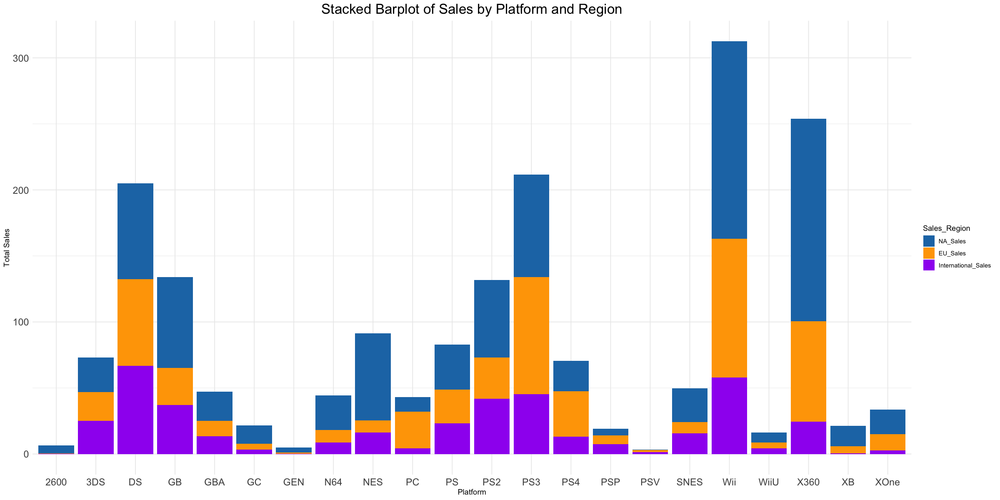

In [8]:
#import this library to reshape the data
library(reshape2)

# determine size of plots
options(repr.plot.width = 20, repr.plot.height = 10)

#create another column to use on our calculations
turtles_sales_df$International_Sales <- turtles_sales_df$Global_Sales -(turtles_sales_df$NA_Sales+turtles_sales_df$EU_Sales)



# Calculate total sales for each platform and sales region
platform_sales <- aggregate(cbind(NA_Sales, EU_Sales, International_Sales) ~ Platform, data = turtles_sales_df, sum)

# Reshape the data from wide to long format
platform_sales_long <- melt(platform_sales, id.vars = "Platform", variable.name = "Sales_Region", value.name = "Total_Sales")

# Define colorblind-friendly colors
colors <- c("NA_Sales" = "#1F77B4", "EU_Sales" = "#FFA500", "International_Sales" = "purple")


# Create a stacked barplot with colorblind-friendly colors
ggplot(platform_sales_long, aes(x = Platform, y = Total_Sales, fill = Sales_Region)) +
  geom_bar(stat = "identity") +
  labs(title = "Stacked Barplot of Sales by Platform and Region", x = "Platform", y = "Total Sales") +
  theme_minimal() +   scale_fill_manual(values = colors) + theme(axis.text = element_text(size = 14),
                                                                plot.title = element_text(size = 20, hjust = 0.5))

## 2c) Boxplots


In [9]:
# Create a boxplot with a slider
combined_boxplot <- plot_ly(data = turtles_sales_df, x = ~Platform, y = ~NA_Sales, type = 'box', name = "NA Sales") %>%
  add_boxplot(x = ~Platform, y = ~EU_Sales, name = "EU Sales", visible = FALSE) %>%
  add_boxplot(x = ~Platform, y = ~Global_Sales, name = "Global Sales", visible = FALSE) %>%
  layout(
    xaxis = list(title = "Platform"),
    yaxis = list(title = "Sales"),
    sliders = list(
      list(
        currentvalue = list(prefix = 'Sales: '),
        steps = list(
          list(args = list('visible', c(TRUE, FALSE, FALSE)), label = 'NA Sales'),
          list(args = list('visible', c(FALSE, TRUE, FALSE)), label = 'EU Sales'),
          list(args = list('visible', c(FALSE, FALSE, TRUE)), label = 'Global Sales')
        )
      )
    )
  )

# Show the combined plot
combined_boxplot


HTML widgets cannot be represented in plain text (need html)

***3 A. Investigating outliers between NA & EU***

In [10]:
# Calculate IQR and identify outliers using Tukey's Fences
tukey_outliers <- function(data) {
  Q1 <- quantile(data, 0.25)
  Q3 <- quantile(data, 0.75)
  IQR_value <- Q3 - Q1
  lower_fence <- Q1 - 1.5 * IQR_value
  upper_fence <- Q3 + 1.5 * IQR_value
  outliers <- data[data < lower_fence | data > upper_fence]
  return(outliers)
}

# Calculate outliers for each market
na_outliers <- tukey_outliers(turtles_sales_df$NA_Sales)
eu_outliers <- tukey_outliers(turtles_sales_df$EU_Sales)

# Create a data frame to store outliers for NA Sales and EU Sales
outliers_df <- data.frame(
  Market = c("NA Sales", "EU Sales"),
  Outliers = c(
    paste(na_outliers, collapse = ", "),
    paste(eu_outliers, collapse = ", ")
  )
)

# Print the formatted table
outliers_df



Market,Outliers
<chr>,<chr>
NA Sales,"34.02, 23.85, 13, 12.92, 9.24, 19.02, 9.33, 11.5, 11.96, 22.08, 7.44, 8.04, 7.38, 7.33, 7.45, 12.28, 7.73, 10.48, 8.88, 7.82, 7.9, 7.4, 7.93"
EU Sales,"23.8, 10.56, 9.03, 7.29, 7.57, 7.54, 5.79, 9.02, 6.21, 5.07, 6.58, 7.04, 7.6, 7.59, 4.82, 4.97, 5.26, 5.09"


***3b. What are the most popular platforms per market?***

In [11]:
# Group the data by platform and calculate the sum of sales for each platform
platform_sales <- turtles_sales_df %>%
  group_by(Platform) %>%
  summarise(
    Total_NA_Sales = sum(NA_Sales),
    Total_EU_Sales = sum(EU_Sales),
    Total_Global_Sales = sum(Global_Sales)
  )

# View the platform_sales data frame
platform_sales

Platform,Total_NA_Sales,Total_EU_Sales,Total_Global_Sales
<chr>,<dbl>,<dbl>,<dbl>
2600,5.97,0.37,6.40
3DS,26.41,21.61,73.20
DS,72.56,65.60,205.02
GB,68.66,28.18,133.97
GBA,21.97,11.60,47.10
GC,13.76,4.70,21.66
GEN,3.67,0.98,4.94
N64,26.42,9.36,44.50
NES,66.05,9.14,91.40


Selecting by Sales
Selecting by Sales
Selecting by Sales


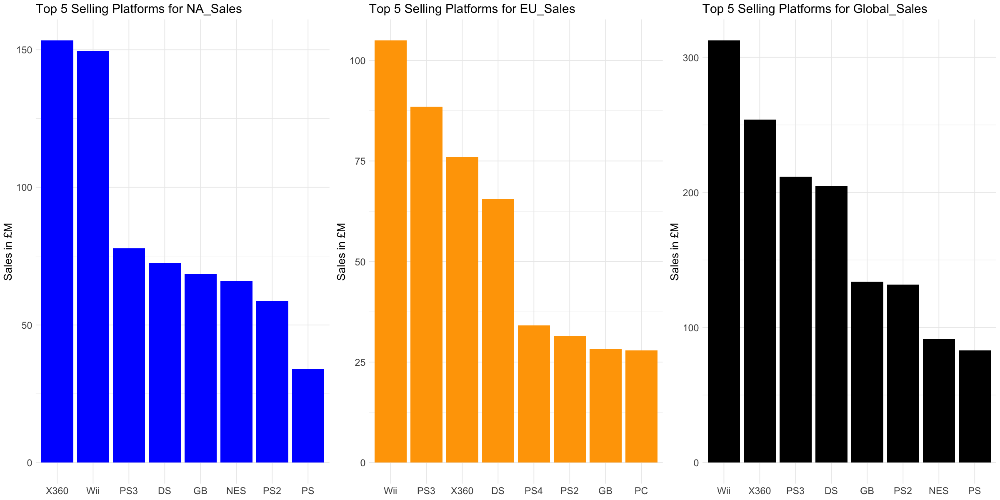

In [12]:
# Load necessary libraries
library(ggplot2)
library(dplyr)
library(gridExtra)

# Create a list of markets
markets <- c("NA_Sales", "EU_Sales", "Global_Sales")

# Define a color map for each market
color_map <- c("NA_Sales" = "blue", "EU_Sales" = "orange", "Global_Sales" = "black")

# Initialize an empty list to store the plots
plots <- list()

# Loop through each market
for (market in markets) {
  # Group the data by "Platform" and calculate the sum of sales for the current market
  top_platforms <- turtles_sales_df %>%
    group_by(Platform) %>%
    summarise(Sales = sum(.data[[market]])) %>%
    arrange(desc(Sales)) %>%
    top_n(8)
  
  # Create a vertical bar plot for the current market using the color from the color_map
plot <- ggplot(top_platforms, aes(x = reorder(Platform, -Sales), y = Sales, fill = Platform)) +
    geom_bar(stat = "identity") +
    labs(title = paste("Top 5 Selling Platforms for", market),
         x = "Platform",
         y = "Sales in £M") +
    theme_minimal() +
    scale_fill_manual(values = rep(color_map[[market]], nrow(top_platforms))) +
    theme(legend.position = "none",  
          axis.text.x = element_text(size = 14),     
          axis.text.y = element_text(size = 14),     
          plot.title = element_text(size = 18), 
          axis.title.x = element_blank(),            
          axis.title.y = element_text(size = 16))    

  
  # Append the plot to the list
  plots[[market]] <- plot
}

# Display the plots side by side
grid.arrange(grobs = plots, nrow = 1)


## Week 5 assignment: Cleaning and maniulating data using R


In [13]:
#Average sales by channel and overall
cat(sprintf("The mean sales per product in NA are: £%.2fM\n", mean(turtles_sales_df$NA_Sales)))
cat(sprintf("The mean sales per product in EU are: £%.2fM\n", mean(turtles_sales_df$EU_Sales)))
cat(sprintf("The mean Global market sales per product are: £%.2fM\n", mean(turtles_sales_df$Global_Sales)))


The mean sales per product in NA are: £2.52M
The mean sales per product in EU are: £1.64M
The mean Global market sales per product are: £5.33M


In [14]:
#Minimum sales by channel and overall
cat(sprintf("The minimum sales per product in NA are: £%.2fM\n", min(turtles_sales_df$NA_Sales)))
cat(sprintf("The minimum sales per product in EU are: £%.2fM\n", min(turtles_sales_df$EU_Sales)))
cat(sprintf("The minimum Global market sales per product are: £%.2fM\n", min(turtles_sales_df$Global_Sales)))



The minimum sales per product in NA are: £0.00M
The minimum sales per product in EU are: £0.00M
The minimum Global market sales per product are: £0.01M


In [15]:
#Maximum sales by channel and overall
cat(sprintf("The maximum sales per product in NA are: £%.2f M\n", max(turtles_sales_df$NA_Sales)))
cat(sprintf("The maximum sales per product in EU are: £%.2f M\n", max(turtles_sales_df$EU_Sales)))
cat(sprintf("The maximum Global market sales per product are: £%.2f M\n", max(turtles_sales_df$Global_Sales)))



The maximum sales per product in NA are: £34.02 M
The maximum sales per product in EU are: £23.80 M
The maximum Global market sales per product are: £67.85 M


In [16]:
# View the descriptive statistics.

summary(turtles_sales_df)

    Product      Platform            NA_Sales          EU_Sales     
 3645   :  9   Length:352         Min.   : 0.0000   Min.   : 0.000  
 2518   :  8   Class :character   1st Qu.: 0.4775   1st Qu.: 0.390  
 3967   :  8   Mode  :character   Median : 1.8200   Median : 1.170  
 3887   :  7                      Mean   : 2.5160   Mean   : 1.644  
 9080   :  7                      3rd Qu.: 3.1250   3rd Qu.: 2.160  
 1945   :  6                      Max.   :34.0200   Max.   :23.800  
 (Other):307                                                        
  Global_Sales    Combined_Label     International_Sales
 Min.   : 0.010   Length:352         Min.   : 0.000     
 1st Qu.: 1.115   Class :character   1st Qu.: 0.110     
 Median : 4.320   Mode  :character   Median : 0.610     
 Mean   : 5.335                      Mean   : 1.175     
 3rd Qu.: 6.435                      3rd Qu.: 1.458     
 Max.   :67.850                      Max.   :10.030     
                                                 

## 2. Determine the impact on sales per product_id.

In [17]:
## 2a) Use the group_by and aggregate functions.
# Group data based on Product and determine the sum per Product.

turtles_group <- turtles_sales_df %>% group_by(Product) %>% summarise(
  Total_EU_Sales = sum(EU_Sales),
  Total_NA_Sales = sum(NA_Sales),
  Total_Global_Sales = sum(Global_Sales),
)


# View the data frame.
head(turtles_group)


Product,Total_EU_Sales,Total_NA_Sales,Total_Global_Sales
<fct>,<dbl>,<dbl>,<dbl>
107,23.80,34.02,67.85
123,4.01,26.64,37.16
195,10.56,13.00,29.37
231,9.03,12.92,27.06
249,7.29,9.24,25.72
254,2.42,21.46,29.39


In [18]:
# Explore the data frame.
summary(turtles_group)

    Product    Total_EU_Sales   Total_NA_Sales   Total_Global_Sales
 107    :  1   Min.   : 0.000   Min.   : 0.060   Min.   : 4.200    
 123    :  1   1st Qu.: 1.460   1st Qu.: 2.495   1st Qu.: 5.515    
 195    :  1   Median : 2.300   Median : 3.610   Median : 8.090    
 231    :  1   Mean   : 3.306   Mean   : 5.061   Mean   :10.730    
 249    :  1   3rd Qu.: 4.025   3rd Qu.: 5.570   3rd Qu.:12.785    
 254    :  1   Max.   :23.800   Max.   :34.020   Max.   :67.850    
 (Other):169                                                       

## 2b) Determine which plot is the best to compare game sales.


***Create a product_id focused dataframe for each market - focus on the top 25 products***


In [19]:
# Create a product_id focused dataframe for each market - focus on the top 25 products

# Arrange the data frame by Total_Global_Sales in descending order and select the top 25 rows
top_products <- turtles_group %>%
  arrange(desc(Total_Global_Sales
)) %>%
  head(25)

# Arrange the data frame by Total_NA_Sales in descending order and select the top 25 rows
top_products_na <- turtles_group %>%
  arrange(desc(Total_NA_Sales)) %>%
  head(25)

# Arrange the data frame by Total_EU_Sales in descending order and select the top 25 rows
top_products_eu <- turtles_group %>%
  arrange(desc(Total_EU_Sales)) %>%
  head(25)


***A. Selecting a plot - Using the Global Sales to determine best options***

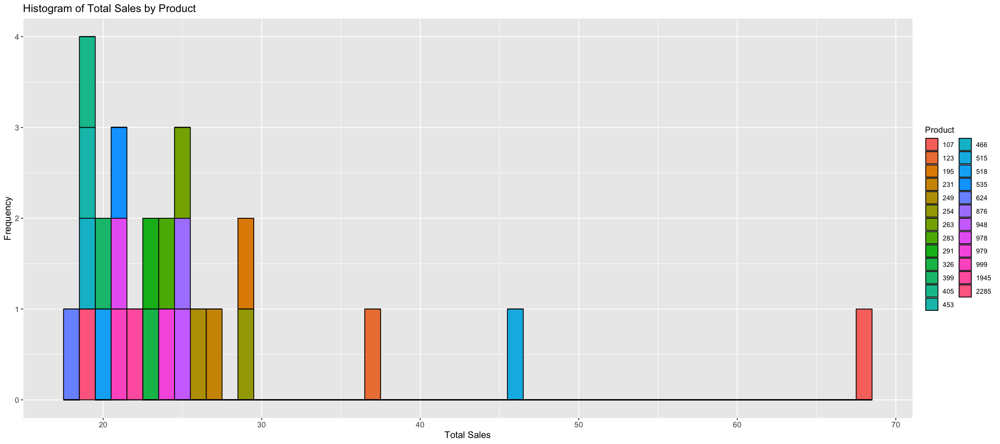

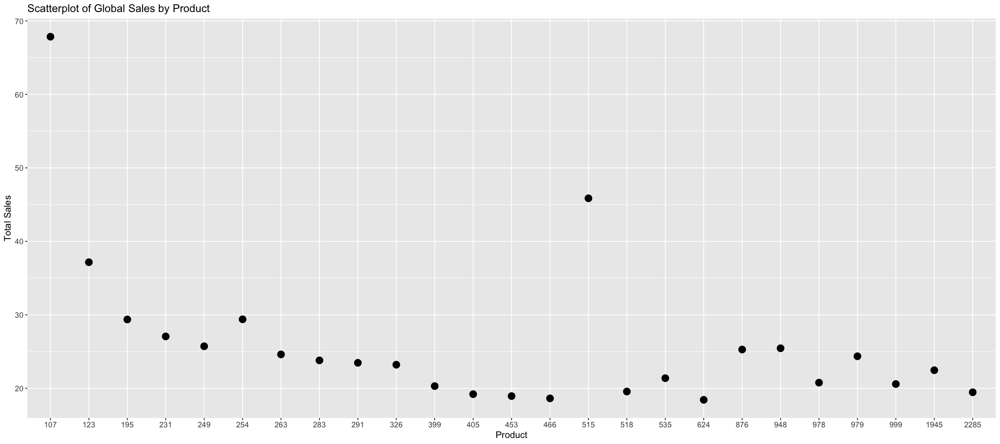

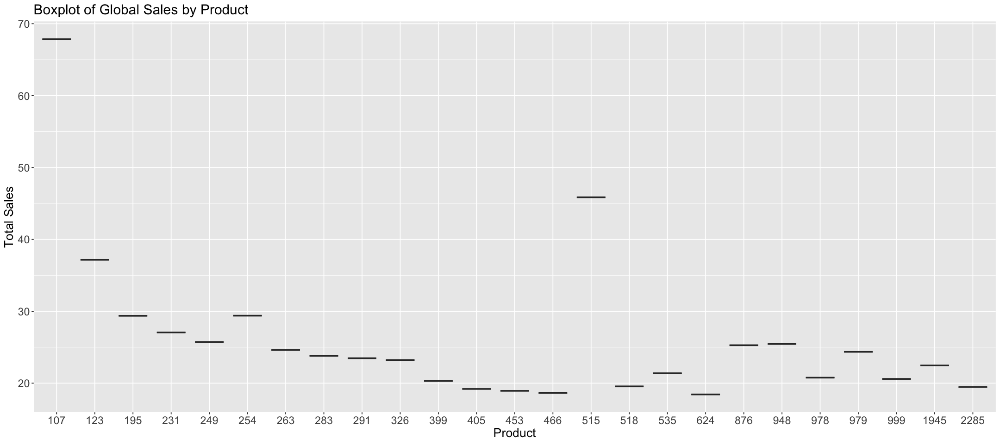

In [20]:
# Set the size of the plots when displaying them
options(repr.plot.width = 18, repr.plot.height = 8)  # Adjust the width and height 

# Create a histogram of Total Sales colored by Product
histogram_plot <- ggplot(data = top_products, aes(x = Total_Global_Sales, fill = factor(Product))) +
  geom_histogram(binwidth = 1, color = "black") +
  labs(title = "Histogram of Total Sales by Product", x = "Total Sales", y = "Frequency") +
  scale_fill_discrete(name = "Product") +
  theme(
    axis.text.x = element_text(size = 10),  # Adjust X-axis tick label size
    axis.text.y = element_text(size = 10),  # Adjust Y-axis tick label size
    axis.title.x = element_text(size = 12),  # Adjust X-axis title size
    axis.title.y = element_text(size = 12),  # Adjust Y-axis title size
    plot.title = element_text(size = 14)  # Adjust plot title size
  )

# Create a scatterplot
scatterplot_plot <- ggplot(data = top_products, aes(x = factor(Product), y = Total_Global_Sales)) +
  geom_point(size = 4) +
  labs(title = "Scatterplot of Global Sales by Product", x = "Product", y = "Total Sales") +
  theme(
    axis.text.x = element_text(size = 10),  # Adjust X-axis tick label size
    axis.text.y = element_text(size = 10),  # Adjust Y-axis tick label size
    axis.title.x = element_text(size = 12),  # Adjust X-axis title size
    axis.title.y = element_text(size = 12),  # Adjust Y-axis title size
    plot.title = element_text(size = 14)  # Adjust plot title size
  )

# Create a boxplot
boxplot_plot <- ggplot(data = top_products, aes(x = factor(Product), y = Total_Global_Sales)) +
  geom_boxplot() +
  labs(title = "Boxplot of Global Sales by Product", x = "Product", y = "Total Sales") +
  theme(
    axis.text.x = element_text(size = 14),  # Adjust X-axis tick label size
    axis.text.y = element_text(size = 14),  # Adjust Y-axis tick label size
    axis.title.x = element_text(size = 16),  # Adjust X-axis title size
    axis.title.y = element_text(size = 16),  # Adjust Y-axis title size
    plot.title = element_text(size = 18)  # Adjust plot title size
  )

# Display the plots
histogram_plot
scatterplot_plot
boxplot_plot


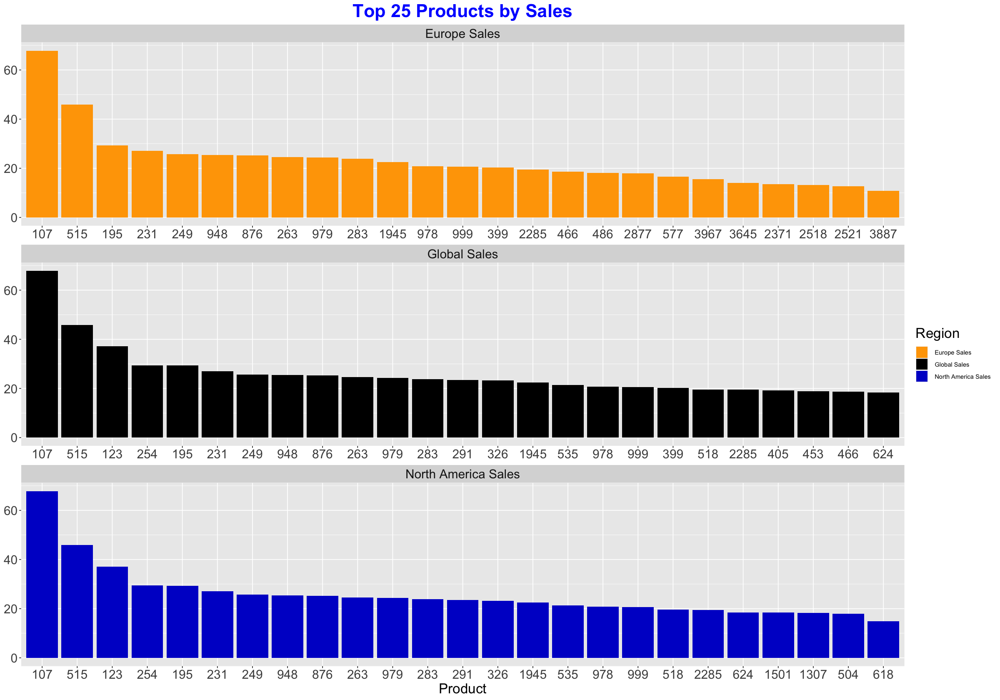

In [21]:
#Create a bar-plot for all markets

# Combine the top products for all regions
combined_top_products <- rbind(
  transform(top_products, Region = "Global Sales"),
  transform(top_products_na, Region = "North America Sales"),
  transform(top_products_eu, Region = "Europe Sales")
)

# Create a ggplot with facets
gg <- ggplot(combined_top_products, aes(x = reorder(Product, -Total_Global_Sales), y = Total_Global_Sales)) +
  geom_bar(stat = "identity", aes(fill = Region)) +
  labs(x = "Product", y = NULL) +
  ggtitle("Top 25 Products by Sales") +
  theme(
    plot.title = element_text(size = 26, face = "bold", hjust = 0.5, color = "blue"),  
    axis.title.y = element_blank(),  # Remove Y-axis title
    axis.text.x = element_text(size = 18),  # Adjust X-axis tick label size
    axis.text.y = element_text(size = 18),  # Adjust Y-axis tick label size
    axis.title.x = element_text(size = 20, color = "black"),  # Larger and black X-axis label
    legend.title = element_text(size = 20)  # Adjust legend title size
  ) +
  scale_fill_manual(values = c("Global Sales" = "black", "North America Sales" = "#0000CD", "Europe Sales" = "#FFA500")) +
  facet_wrap(~Region, scales = "free_x", ncol = 1) +  # Ensure a white background
  theme(
    strip.text = element_text(size = 18)  # Adjust strip text size (facet labels)
  )

# Set the size of the plot when displaying it
options(repr.plot.width = 20, repr.plot.height = 14)  # Adjust the width and height

gg  # Display the plot


In [22]:
#Identify the most common games across all markets
# Extract the list of games from each data frame
games_global <- top_products$Product
games_na <- top_products_na$Product
games_eu <- top_products_eu$Product

# Find the common games using the intersect function
common_games <- Reduce(intersect, list(games_global, games_na, games_eu))

# Create separate data frames for each market with only the common games
common_games_df <- top_products[top_products$Product %in% common_games, ]
common_games_df


Product,Total_EU_Sales,Total_NA_Sales,Total_Global_Sales
<fct>,<dbl>,<dbl>,<dbl>
107,23.80,34.02,67.85
515,18.88,19.25,45.86
195,10.56,13.00,29.37
231,9.03,12.92,27.06
249,7.29,9.24,25.72
948,7.79,14.42,25.45
876,9.25,12.77,25.28
263,7.57,9.33,24.61
979,9.07,11.55,24.36


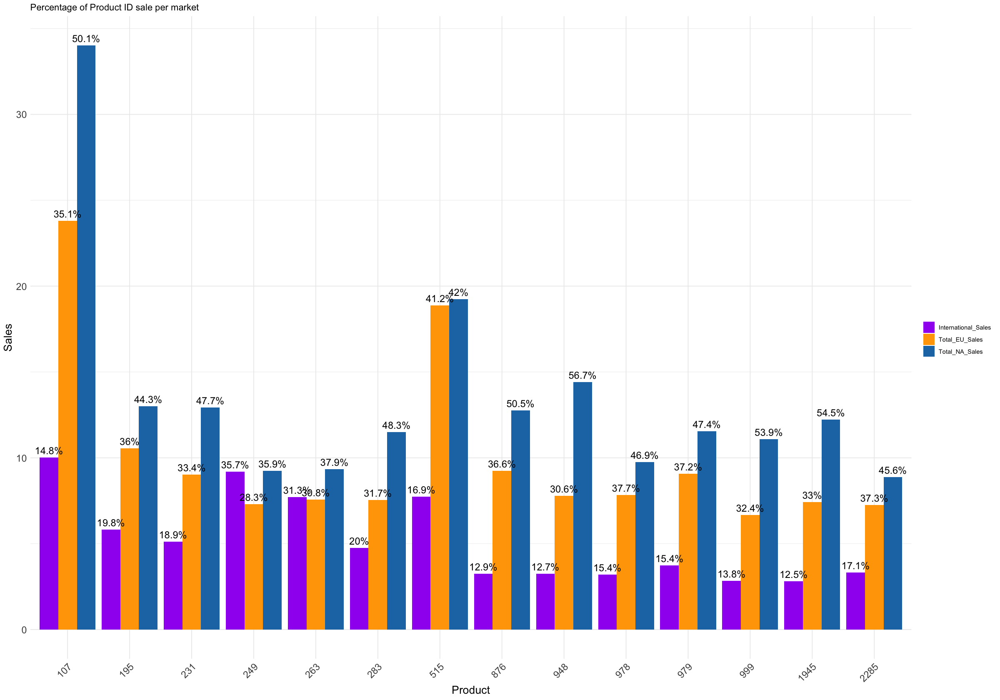

In [23]:
# Calculate International sales
common_games_filtered <- common_games_df %>%
  mutate(International_Sales = Total_Global_Sales - (Total_EU_Sales + Total_NA_Sales))

# Reshape the data into long format
common_games_long <- common_games_filtered %>%
  select(Product, Total_NA_Sales, Total_EU_Sales, International_Sales) %>%
  pivot_longer(cols = c(Total_NA_Sales, Total_EU_Sales, International_Sales), 
               names_to = "Market", values_to = "Sales")

# Calculate the percentages
common_games_long <- common_games_long %>%
  group_by(Product) %>%
  mutate(Percentage = (Sales / sum(Sales)) * 100)

# Create the bar plot with adjusted text sizes
ggplot(common_games_long, aes(x = Product, y = Sales, fill = Market, label = paste0(round(Percentage, 1), "%"))) +
  geom_bar(stat = "identity", position = "dodge") +
  geom_text(position = position_dodge(width = 0.9), vjust = -0.5, size = 5) +
  labs(title = "Percentage of Product ID sale per market",
       x = "Product",
       y = "Sales") +
  scale_fill_manual(values = c("Total_EU_Sales" = "orange", "Total_NA_Sales" = "#1F77B4", "International_Sales" = "purple")) +
  theme_minimal() +
  theme(legend.title = element_blank(), 
        axis.text.x = element_text(size = 14,  angle = 45, hjust = 1),
        axis.text.y = element_text(size = 14),
        axis.title = element_text(size = 16))


# 3. Determine the normality of the data set.


In [24]:
# Install and import Moments.
install.packages("moments")
library(moments)


The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages


**EU Sales**

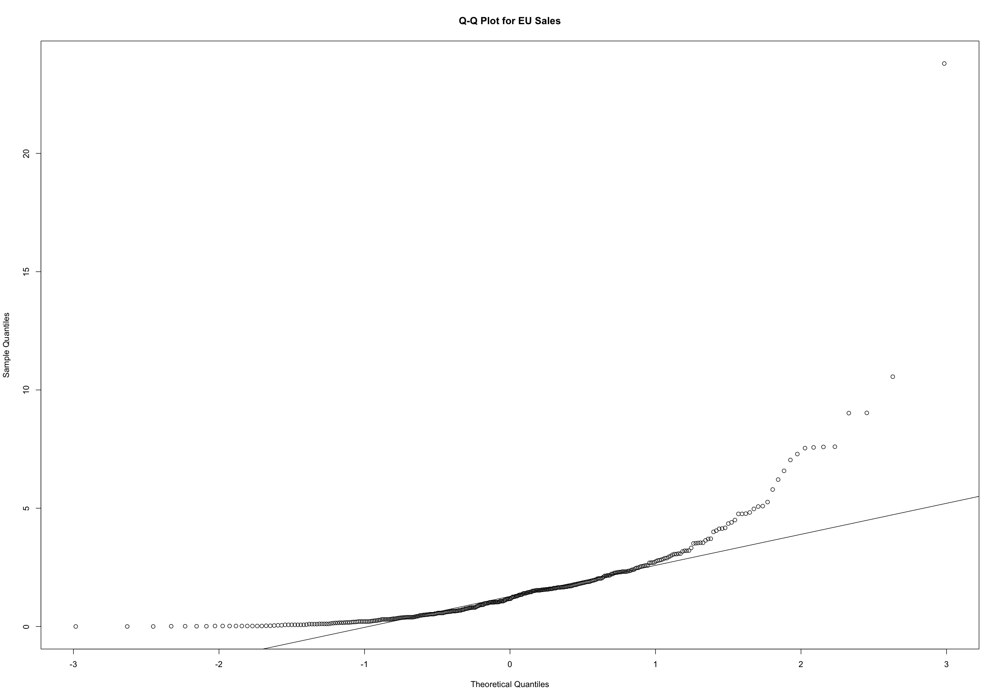

In [25]:
# Create Q-Q Plot for EU Sales
qqnorm(turtles_sales_df$EU_Sales, main = '')
qqline(turtles_sales_df$EU_Sales)

title(main = "Q-Q Plot for EU Sales")



In [26]:
#Perform Shapiro-Wilk test

shapiro.test(turtles_sales_df$EU_Sales)


#Determine Skewness and Kurtosis

cat(sprintf("The skewness in EU sales is: %.2f \n", skewness(turtles_sales_df$EU_Sales)))
cat(sprintf("Kurtosis in EU sales is: %.2f \n", kurtosis(turtles_sales_df$EU_Sales)))




	Shapiro-Wilk normality test

data:  turtles_sales_df$EU_Sales
W = 0.64687, p-value < 2.2e-16


The skewness in EU sales is: 4.82 
Kurtosis in EU sales is: 44.69 


**NA Sales**

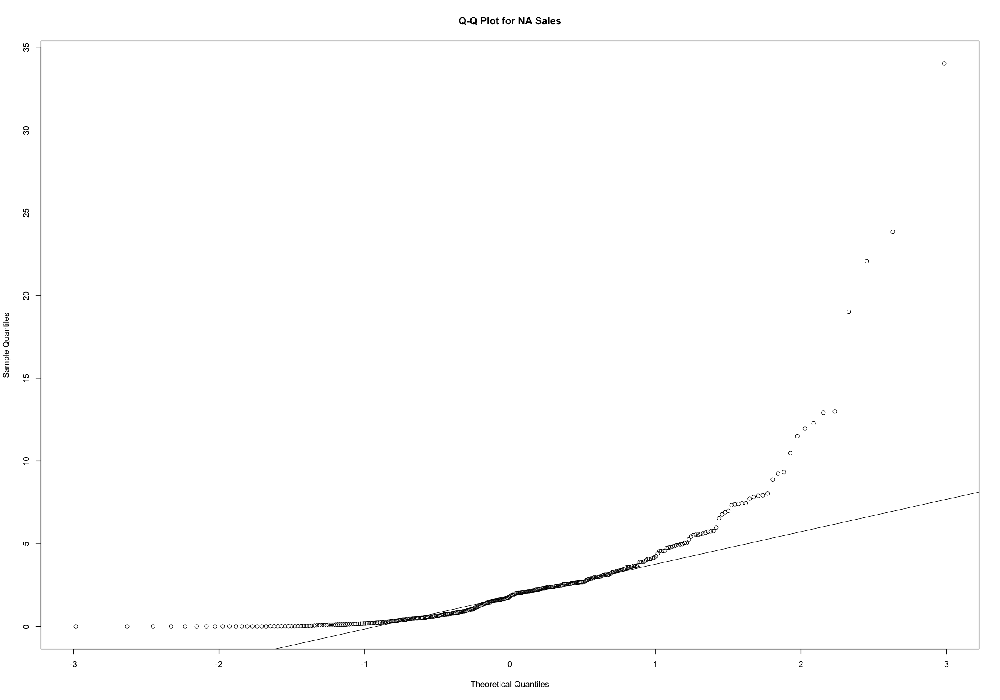

In [27]:
# Create Q-Q Plot for NA Sales
qqnorm(turtles_sales_df$NA_Sales, main = '')
qqline(turtles_sales_df$NA_Sales)

title(main = "Q-Q Plot for NA Sales")

In [28]:
#Perform Shapiro-Wilk test

shapiro.test(turtles_sales_df$NA_Sales)


#Determine Skewness and Kurtosis

cat(sprintf("The skewness in NA sales is: %.2f \n", skewness(turtles_sales_df$NA_Sales)))
cat(sprintf("Kurtosis in NA sales is: %.2f \n", kurtosis(turtles_sales_df$NA_Sales)))


	Shapiro-Wilk normality test

data:  turtles_sales_df$NA_Sales
W = 0.6293, p-value < 2.2e-16


The skewness in NA sales is: 4.31 
Kurtosis in NA sales is: 31.37 


**Global Sales**

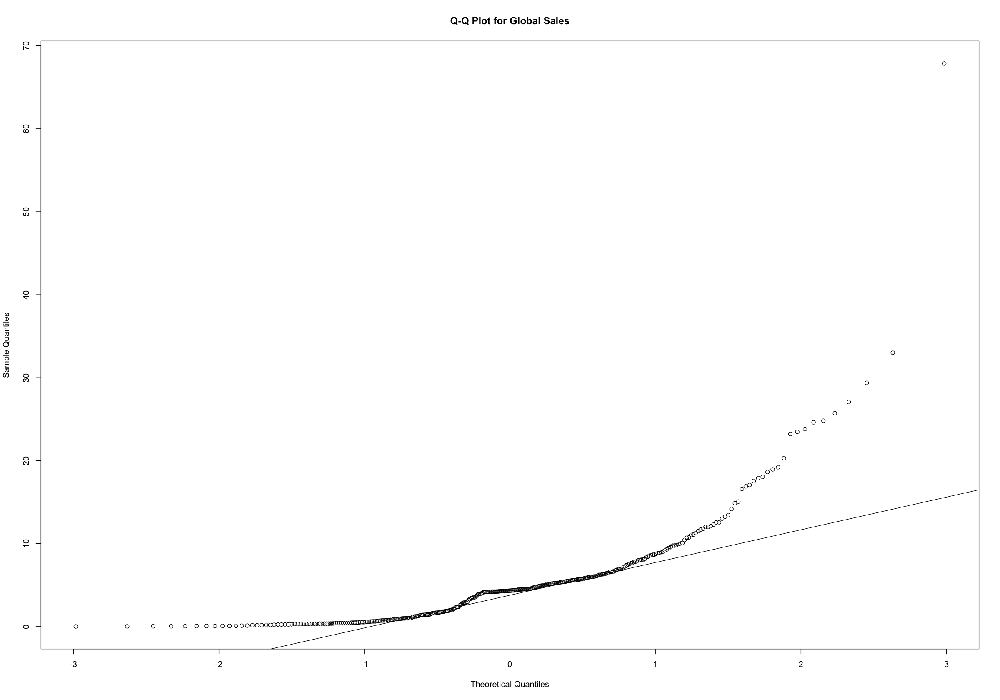

In [29]:
# Create Q-Q Plot for Global Sales
qqnorm(turtles_sales_df$Global_Sales, main = '')
qqline(turtles_sales_df$Global_Sales)

title(main = "Q-Q Plot for Global Sales")




In [30]:
#Perform Shapiro-Wilk test

shapiro.test(turtles_sales_df$Global_Sales)


#Determine Skewness and Kurtosis

cat(sprintf("The skewness in NA sales is: %.2f \n", skewness(turtles_sales_df$Global_Sales)))
cat(sprintf("Kurtosis in NA sales is: %.2f \n", kurtosis(turtles_sales_df$Global_Sales)))


	Shapiro-Wilk normality test

data:  turtles_sales_df$Global_Sales
W = 0.6818, p-value < 2.2e-16


The skewness in NA sales is: 4.05 
Kurtosis in NA sales is: 32.64 


In [31]:
## 3d) Determine correlation
# Determine correlation.

NA_EU_correlation <- cor(turtles_sales_df$NA_Sales, turtles_sales_df$EU_Sales)

NA_Global_correlation <- cor(turtles_sales_df$NA_Sales, turtles_sales_df$Global_Sales)

EU_Global_correlation <- cor(turtles_sales_df$EU_Sales, turtles_sales_df$Global_Sales)


cat(sprintf("The correlation between NA and EU sales is: %.2f \n", NA_EU_correlation))
cat(sprintf("The correlation between NA and Global sales is: %.2f \n", NA_Global_correlation))
cat(sprintf("The correlation between EU and Global sales is: %.2f \n", EU_Global_correlation))




The correlation between NA and EU sales is: 0.71 
The correlation between NA and Global sales is: 0.93 
The correlation between EU and Global sales is: 0.88 


# 4. Plot the data


`geom_smooth()` using formula = 'y ~ x'


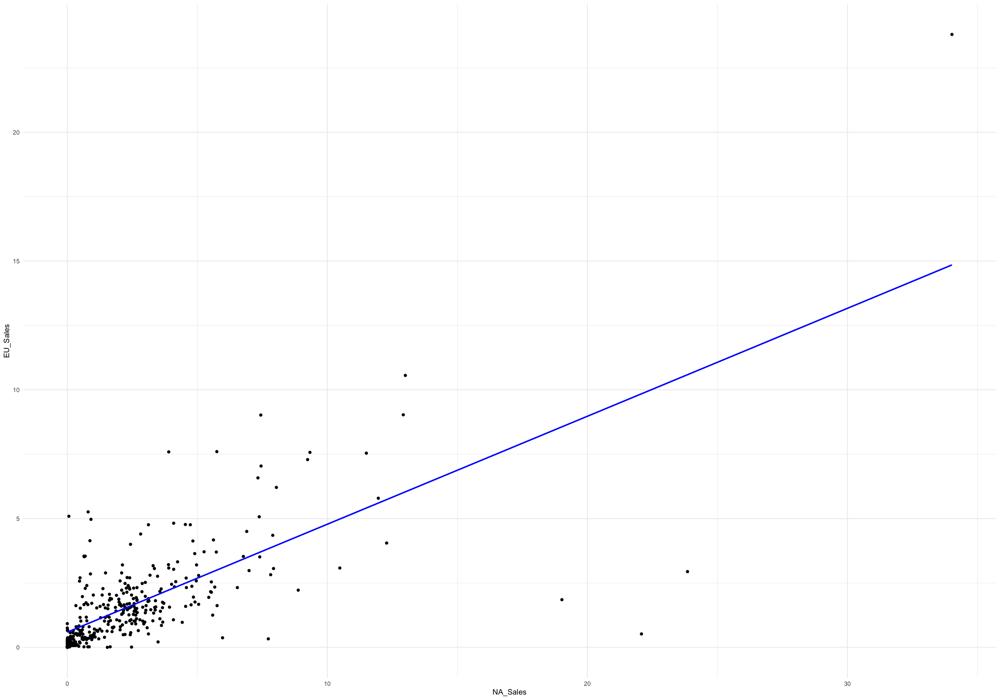

In [32]:
ggplot(turtles_sales_df, aes(x = NA_Sales, y = EU_Sales)) +
  geom_point() +
  geom_smooth(method = "lm", se = FALSE, color = "blue") + # Color the line blue
  theme_minimal()


`geom_smooth()` using formula = 'y ~ x'


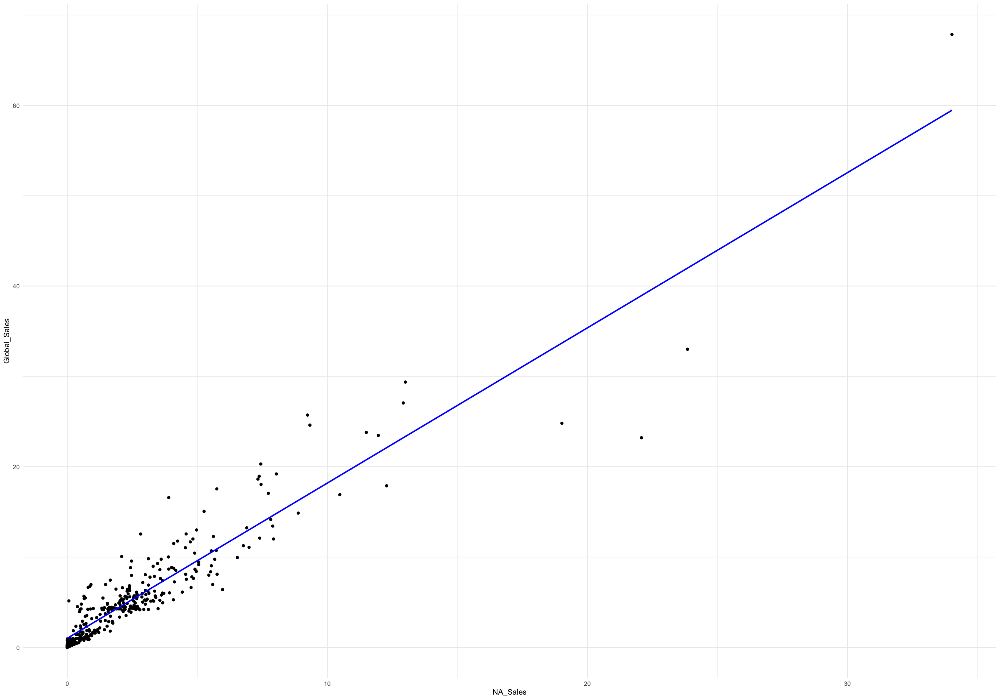

In [33]:
ggplot(turtles_sales_df, aes(x = NA_Sales, y = Global_Sales)) +
  geom_point() +
  geom_smooth(method = "lm", se = FALSE, color = "blue") + # Color the line blue
  theme_minimal()

`geom_smooth()` using formula = 'y ~ x'


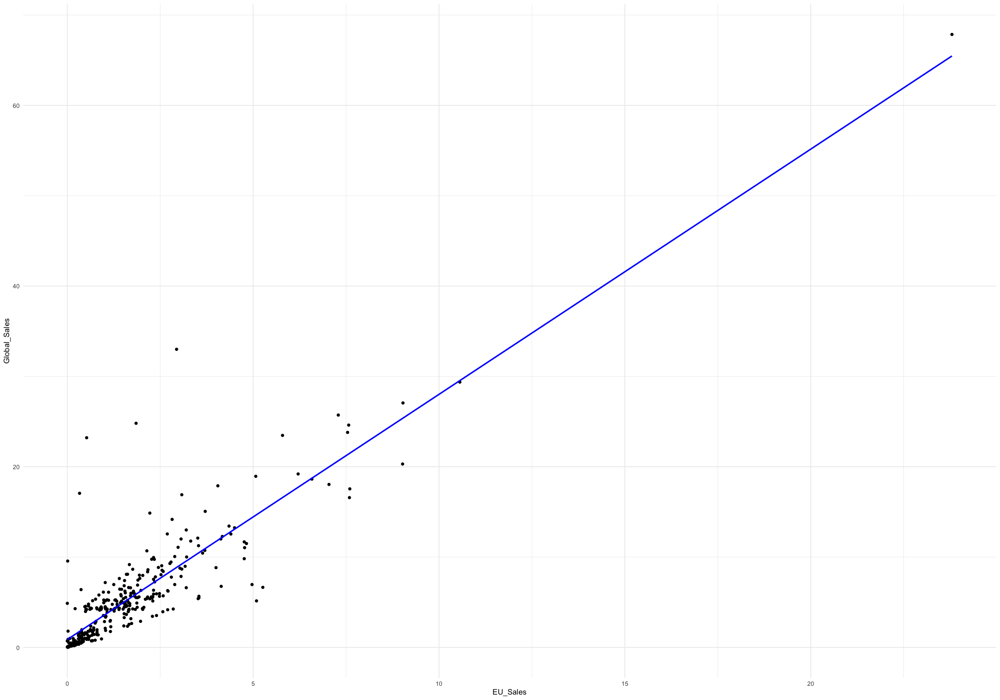

In [34]:
ggplot(turtles_sales_df, aes(x = EU_Sales, y = Global_Sales)) +
  geom_point() +
  geom_smooth(method = "lm", se = FALSE, color = "blue") + # Color the line blue
  theme_minimal()

# Week 6 assignment: Making recommendations to the business using R


In [35]:
# View data frame created in Week 5.
head(turtles_group)

# Determine a summary of the data frame.
summary(turtles_group)

Product,Total_EU_Sales,Total_NA_Sales,Total_Global_Sales
<fct>,<dbl>,<dbl>,<dbl>
107,23.80,34.02,67.85
123,4.01,26.64,37.16
195,10.56,13.00,29.37
231,9.03,12.92,27.06
249,7.29,9.24,25.72
254,2.42,21.46,29.39


    Product    Total_EU_Sales   Total_NA_Sales   Total_Global_Sales
 107    :  1   Min.   : 0.000   Min.   : 0.060   Min.   : 4.200    
 123    :  1   1st Qu.: 1.460   1st Qu.: 2.495   1st Qu.: 5.515    
 195    :  1   Median : 2.300   Median : 3.610   Median : 8.090    
 231    :  1   Mean   : 3.306   Mean   : 5.061   Mean   :10.730    
 249    :  1   3rd Qu.: 4.025   3rd Qu.: 5.570   3rd Qu.:12.785    
 254    :  1   Max.   :23.800   Max.   :34.020   Max.   :67.850    
 (Other):169                                                       

# 2. Create a simple linear regression model


**2a) Determine the correlation between columns**


,NA_Sales,EU_Sales,Global_Sales
NA_Sales,1.0000000,0.7055236,0.9349455
EU_Sales,0.7055236,1.0000000,0.8775575
Global_Sales,0.9349455,0.8775575,1.0000000



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages



Attaching package: ‘psych’


The following objects are masked from ‘package:ggplot2’:

    %+%, alpha




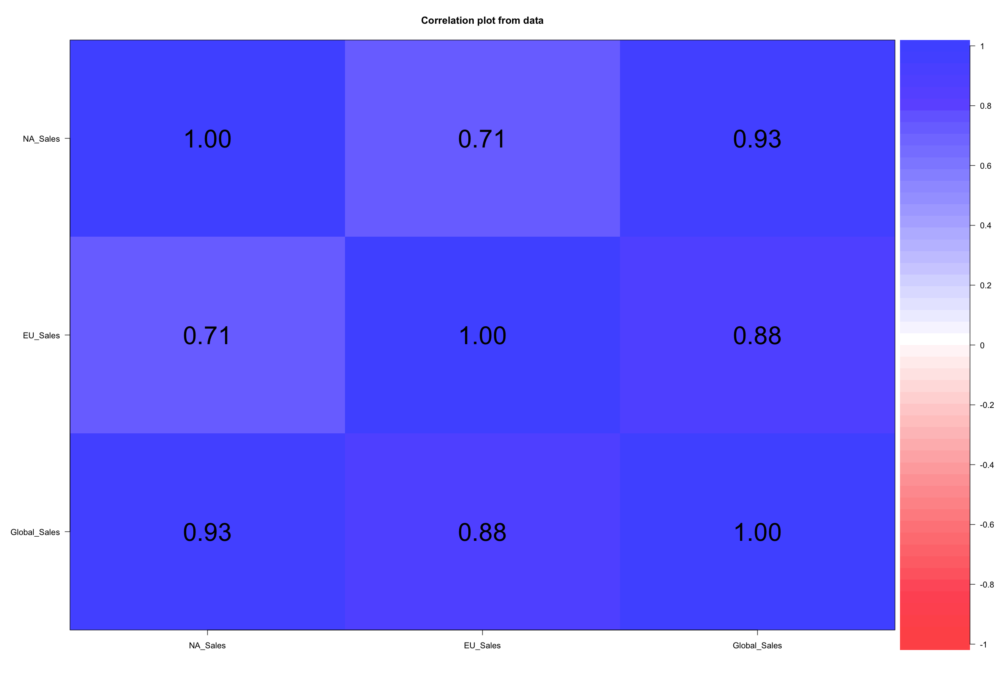

In [36]:
# Remove the non numerical variables
turtles_group_lm <- subset(turtles_sales_df, select = -c(Product, Platform, Combined_Label, International_Sales))
cor(turtles_group_lm)

# Install the psych package.
install.packages('psych')

# Import the psych package.
library(psych)

# Use the corPlot() function.
# Specify the data frame (turtles_group_lm) and set 
# character size (cex=2).
corPlot(turtles_group_lm, cex=2)


***NA - GLOBAL***


Call:
lm(formula = Global_Sales ~ NA_Sales, data = turtles_group_lm)

Residuals:
     Min       1Q   Median       3Q      Max 
-15.7352  -1.0341  -0.5555   0.6247   8.8676 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.01232    0.14752   6.862 3.09e-11 ***
NA_Sales     1.71797    0.03485  49.300  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 2.226 on 350 degrees of freedom
Multiple R-squared:  0.8741,	Adjusted R-squared:  0.8738 
F-statistic:  2430 on 1 and 350 DF,  p-value: < 2.2e-16


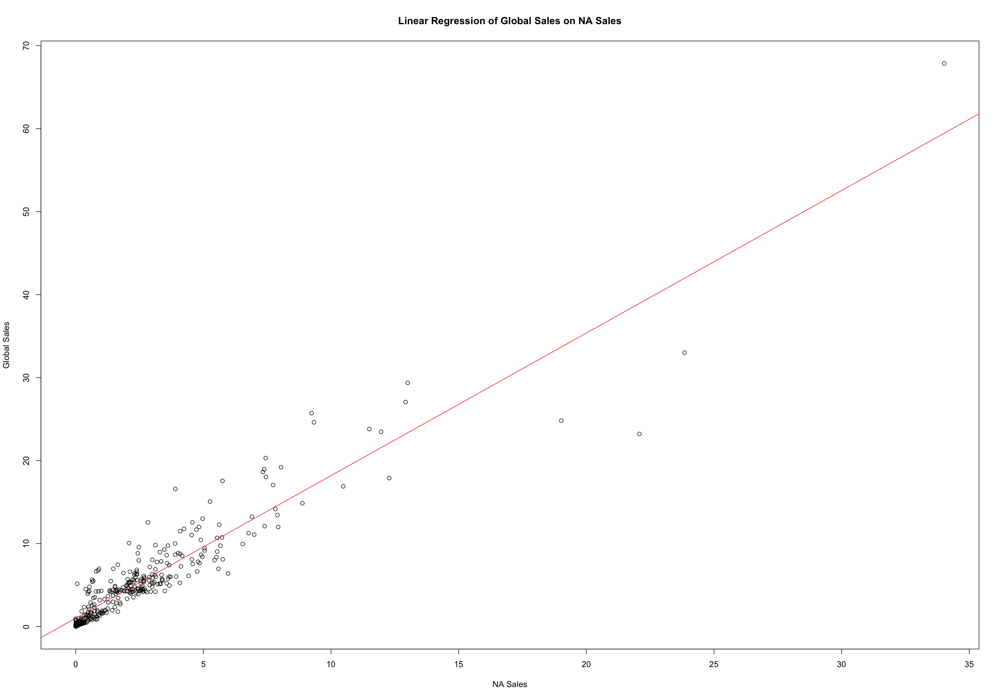

In [37]:
# Fit the linear regression model
global_NA <- lm(Global_Sales ~ NA_Sales, data = turtles_group_lm)

# Plot the data points
plot(turtles_group_lm$Global_Sales ~ turtles_group_lm$NA_Sales, 
     xlab = "NA Sales", ylab = "Global Sales",
     main = "Linear Regression of Global Sales on NA Sales")

# Add the regression line
abline(global_NA, col = "red")

summary(global_NA)



***EU - GLOBAL***


Call:
lm(formula = Global_Sales ~ EU_Sales, data = turtles_group_lm)

Residuals:
    Min      1Q  Median      3Q     Max 
-9.5377 -1.2173 -0.6040  0.8755 24.1474 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.87350    0.20660   4.228 3.01e-05 ***
EU_Sales     2.71399    0.07926  34.241  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 3.008 on 350 degrees of freedom
Multiple R-squared:  0.7701,	Adjusted R-squared:  0.7695 
F-statistic:  1172 on 1 and 350 DF,  p-value: < 2.2e-16


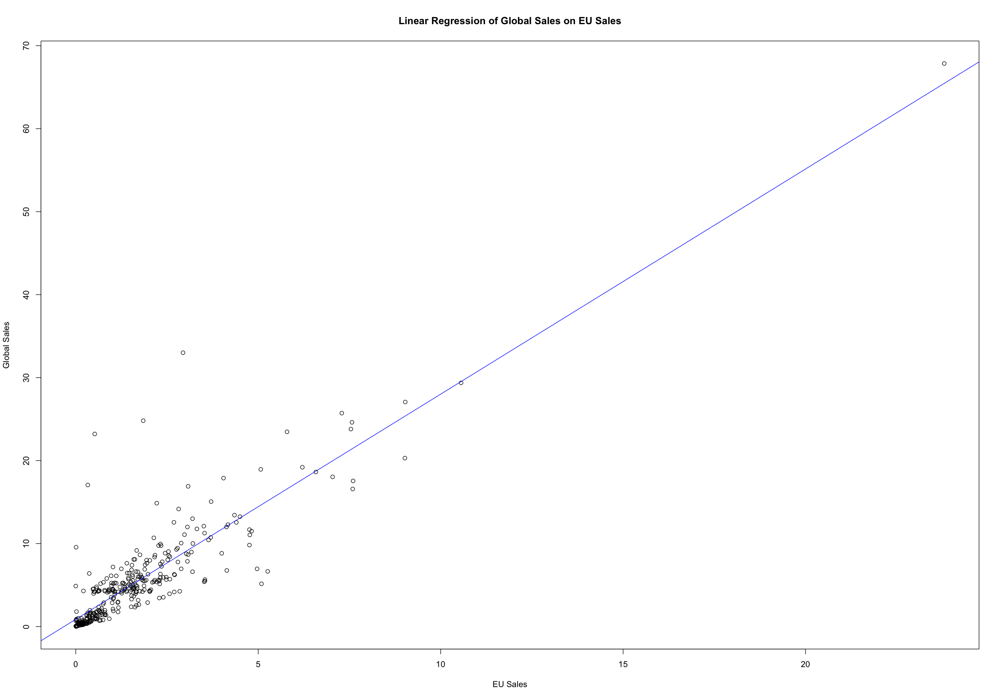

In [38]:
# Fit the linear regression model for EU_Sales
global_eu <- lm(Global_Sales ~ EU_Sales, data = turtles_group_lm)
# Plot the data points for EU_Sales
plot(turtles_group_lm$Global_Sales ~ turtles_group_lm$EU_Sales, 
     xlab = "EU Sales", ylab = "Global Sales",
     main = "Linear Regression of Global Sales on EU Sales")

# Add the regression line for EU_Sales
abline(global_eu, col = "blue")
summary(global_eu)


***EU + NA - GLOBAL***

In [39]:
# Fit the multiple linear regression model with both EU_Sales and NA_Sales
eu_na <- lm(Global_Sales ~ EU_Sales + NA_Sales, data = turtles_group_lm)
summary(eu_na)



Call:
lm(formula = Global_Sales ~ EU_Sales + NA_Sales, data = turtles_group_lm)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.6186 -0.4234 -0.2692  0.0796  7.4639 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.22175    0.07760   2.858  0.00453 ** 
EU_Sales     1.34197    0.04134  32.466  < 2e-16 ***
NA_Sales     1.15543    0.02456  47.047  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 1.112 on 349 degrees of freedom
Multiple R-squared:  0.9687,	Adjusted R-squared:  0.9685 
F-statistic:  5398 on 2 and 349 DF,  p-value: < 2.2e-16


In [40]:
# Predictions with confidence intervals
Sales_prediction <- data.frame(
  EU_Sales = c(23.80, 1.56, 0.65, 0.97, 0.52),
  NA_Sales = c(34.02, 3.93, 2.73, 2.26, 22.08)
)

predictions <- predict(eu_na, newdata = Sales_prediction, interval='confidence')

# Round the results to 2 decimal places
predictions <- round(predictions, 2)

final_df <- data.frame('EU Sales' = Sales_prediction$EU_Sales,
                       'North American Sales' = Sales_prediction$NA_Sales,
                       'Predicted Global Sales' = predictions[, "fit"],
                       'Lower Estimate' = predictions[, "lwr"],
                       'Upper Estimate' = predictions[, "upr"], check.names=FALSE)

final_df

,EU Sales,North American Sales,Predicted Global Sales,Lower Estimate,Upper Estimate
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,23.80,34.02,71.47,70.16,72.77
2,1.56,3.93,6.86,6.72,6.99
3,0.65,2.73,4.25,4.10,4.39
4,0.97,2.26,4.13,4.01,4.26
5,0.52,22.08,26.43,25.41,27.45


***Limitations - Check for multicolinearity***

In [41]:
#Install the necessary packages to check for multicolinearity
install.packages("car")
library(car)



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages


Loading required package: carData


Attaching package: ‘car’


The following object is masked from ‘package:psych’:

    logit


The following object is masked from ‘package:dplyr’:

    recode


The following object is masked from ‘package:purrr’:

    some




In [42]:
# Fit your linear regression model
model <- lm(Global_Sales ~ NA_Sales, data = turtles_group_lm)

# Calculate VIF manually
# VIF = 1 / (1 - R^2)
vif_manual <- 1 / (1 - summary(model)$r.squared)

# Display VIF values
vif_manual


[1] 7.944271

In [43]:
# Fit your linear regression model
model <- lm(Global_Sales ~ EU_Sales, data = turtles_group_lm)

# Calculate VIF manually
# VIF = 1 / (1 - R^2)
vif_manual <- 1 / (1 - summary(model)$r.squared)

# Display VIF values
vif_manual

[1] 4.349854

***The Lasso Regression approach***

In [44]:
install.packages("glmnet")


# install.packages("glmnet") # Uncomment and run if you haven't installed glmnet
library(glmnet)



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages


Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loaded glmnet 4.1-8



In [45]:
# Load necessary libraries
library(glmnet)
library(tidyverse)

# Extracting the training data from turtles_group_lm
X <- as.matrix(turtles_group_lm[, c("NA_Sales", "EU_Sales")])
y <- turtles_group_lm$Global_Sales

# Calculate mean and standard deviation of the training data
X_mean <- apply(X, 2, mean)
X_sd <- apply(X, 2, sd)

# Standardize the training data 
X_scaled <- scale(X, center = X_mean, scale = X_sd)

# Fit the Lasso model using standardized data
lasso_model <- glmnet(X_scaled, y, alpha=1)

# Performing cross-validation to find the optimal lambda
cv_lasso <- cv.glmnet(X_scaled, y, alpha=1)
best_lambda <- cv_lasso$lambda.min

# Prepare the prediction data
Sales_prediction <- data.frame(
  EU_Sales = c(23.80, 1.56, 0.65, 0.97, 0.52),
  NA_Sales = c(34.02, 3.93, 2.73, 2.26, 22.08)
)

# Manually scale the prediction data using the mean and standard deviation of the training data
Sales_prediction_scaled <- as.data.frame(scale(Sales_prediction, center = X_mean, scale = X_sd))
Sales_prediction_matrix <- as.matrix(Sales_prediction_scaled)

# Making predictions using the standardized prediction data
predicted_Global_Sales <- predict(lasso_model, s=best_lambda, newx=Sales_prediction_matrix)

# Appending predictions to the Sales_prediction dataframe
Sales_prediction$Predicted_Global_Sales <- predicted_Global_Sales

Sales_prediction$Predicted_Global_Sales <- round(Sales_prediction$Predicted_Global_Sales, 2)

# Viewing the predictions
Sales_prediction

EU_Sales,NA_Sales,Predicted_Global_Sales
<dbl>,<dbl>,"<dbl[,1]>"
23.80,34.02,71.97
1.56,3.93,7.24
0.65,2.73,4.64
0.97,2.26,4.38
0.52,22.08,29.85


In [46]:
# Load the Metrics library
install.packages("Metrics")
library(Metrics)

# Predict the Global_Sales on the training data
train_predicted <- predict(lasso_model, s=best_lambda, newx=X_scaled)

# Compute accuracy metrics
mae_value <- mae(y, train_predicted)
mse_value <- mse(y, train_predicted)
rmse_value <- rmse(y, train_predicted)

# Print the results
cat("Mean Absolute Error (MAE):", mae_value, "\n")
cat("Mean Squared Error (MSE):", mse_value, "\n")
cat("Root Mean Squared Error (RMSE):", rmse_value, "\n")



The downloaded binary packages are in
	/var/folders/4v/l92sx5r11yl1h_knnkhrkdgh0000gq/T//Rtmpn6lIpI/downloaded_packages
Mean Absolute Error (MAE): 0.7156607 
Mean Squared Error (MSE): 1.238895 
Root Mean Squared Error (RMSE): 1.113057 
